In [1]:
import numpy as np
from tqdm import tqdm
from matplotlib import pyplot as plt
import os
from scipy import interpolate
from sklearn.linear_model import LinearRegression


In [2]:
path = '../data/actin_flow_1d/'

folders = [ x + '/' for x in os.listdir(path) if x.endswith('kymo')]

In [3]:


rhos = [] 
vs = [] 
Qs = [] 
dxdvs = [] 
for f in folders: 
    label = '_'.join(f.split('_')[:2])
    rhos.append(np.load(path + f + label +  '_imagekymo.npy'))
    vs.append(np.load(path + f +  label + '_vkymo.npy'))
    Qs.append(np.load(path + f + label + '_qkymo.npy'))
    dxdvs.append(np.load(path + f + label + '_divkymo.npy'))


In [4]:
def binned_average(rho, n): 
    T, l = rho.shape 
    rho /=600
    rho_reshaped = rho.reshape((T, int(l/n), n))
    rho_averaged = np.mean(rho_reshaped, axis=-1)
    return rho_averaged

In [5]:
m_rhos = [] 
x = np.linspace(0, 1, Qs[0].shape[-1])
newx = np.linspace(0, 1, vs[0].shape[-1])
int_Qs = [] 


for (Q, rho) in zip(Qs, rhos): 
    m_rhos.append(binned_average(rho, 16))
    f = interpolate.interp1d(x, Q, kind='cubic')
    int_Qs.append(f(newx))

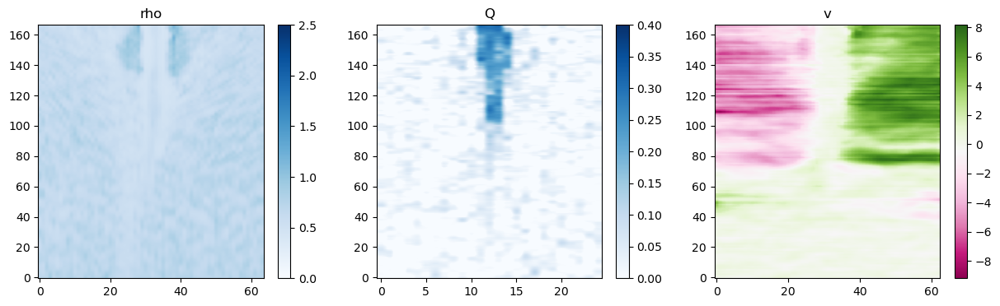

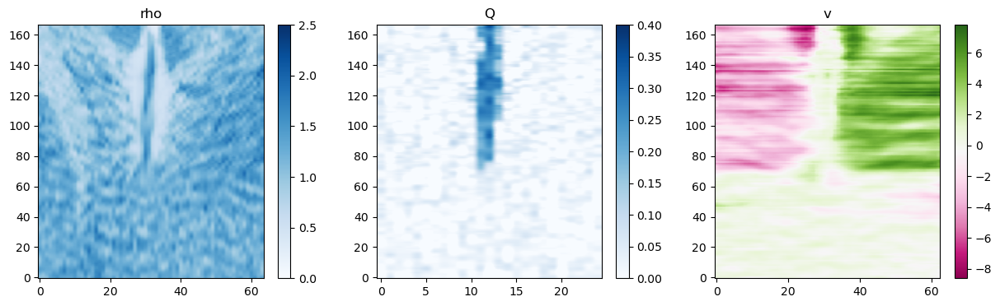

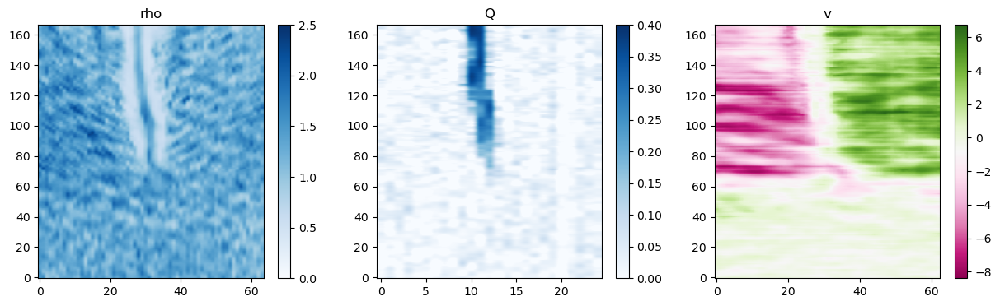

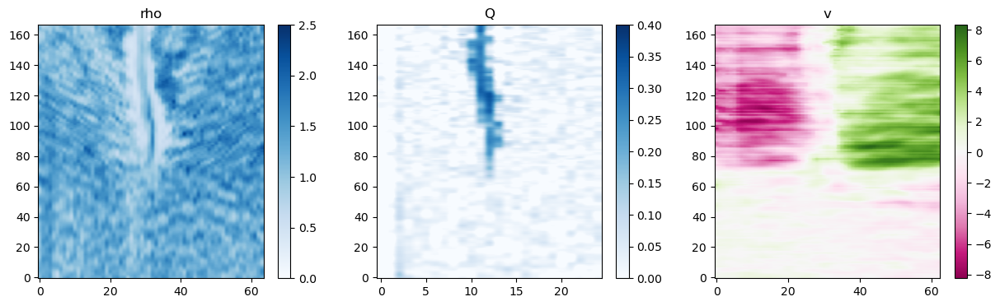

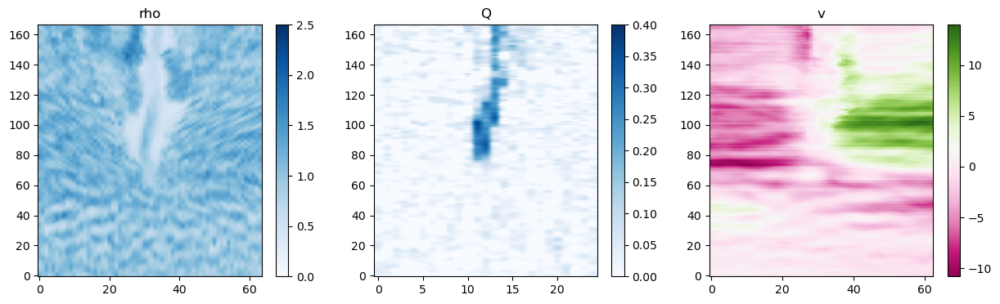

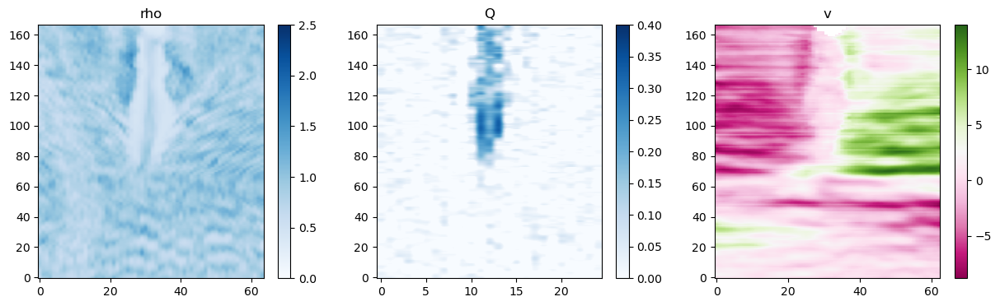

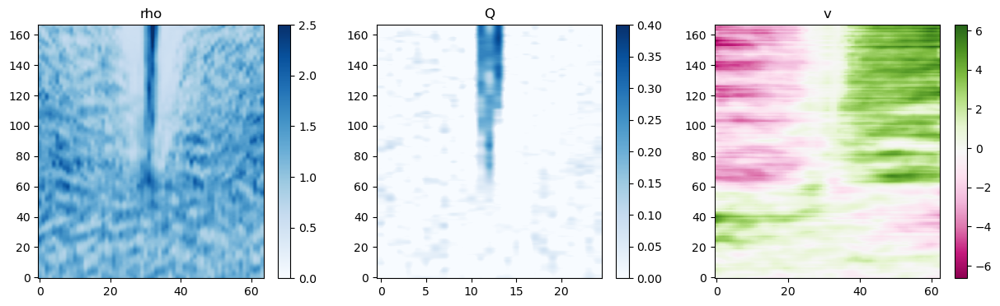

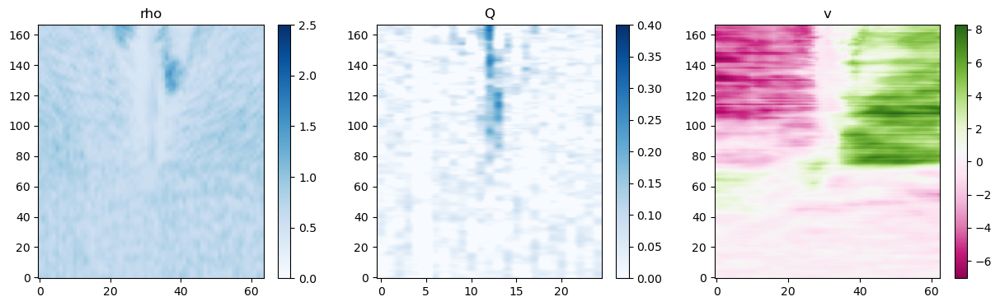

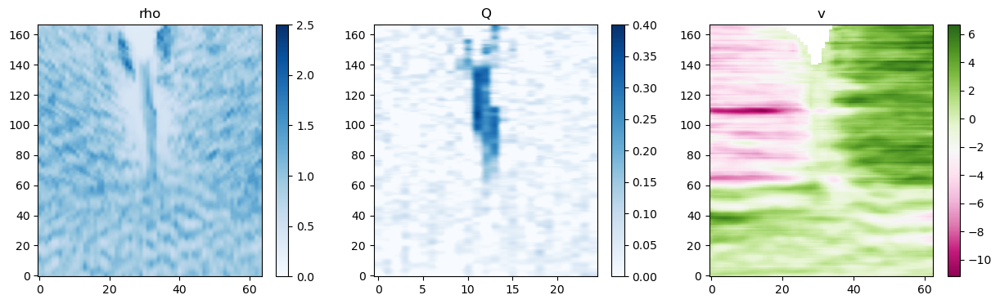

In [6]:
for n in range(len(rhos)):

    fig, axes = plt.subplots(1, 3, figsize=(15, 4))

    im0 = axes[0].imshow(m_rhos[n], origin='lower', aspect='auto', cmap='Blues', vmin=0, vmax=2.5)
    axes[0].set_title('rho')
    fig.colorbar(im0, ax=axes[0])

    im1 = axes[1].imshow(Qs[n], origin='lower', aspect='auto', cmap='Blues', vmin=0, vmax=0.4)
    axes[1].set_title('Q')
    fig.colorbar(im1, ax=axes[1])

    im2 = axes[2].imshow(vs[n], origin='lower', aspect='auto', cmap='PiYG')
    axes[2].set_title('v')
    fig.colorbar(im2, ax=axes[2])

    plt.show() 

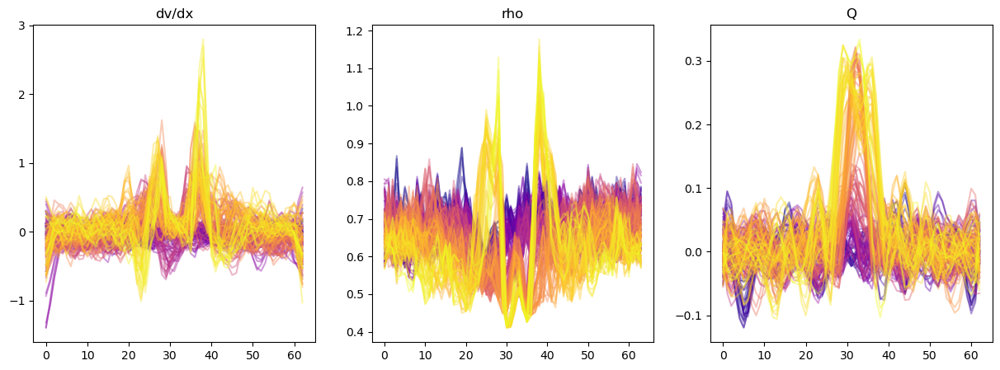

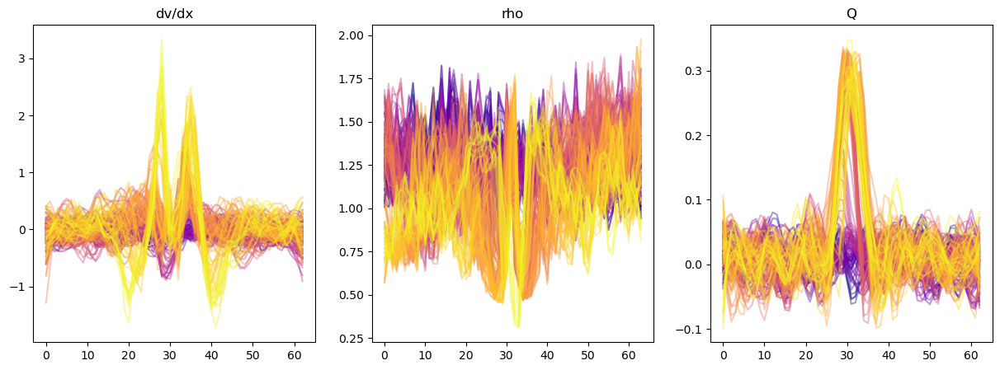

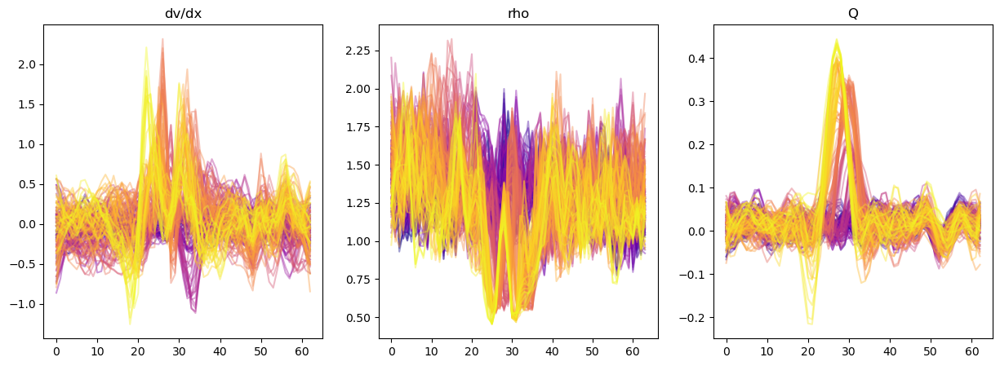

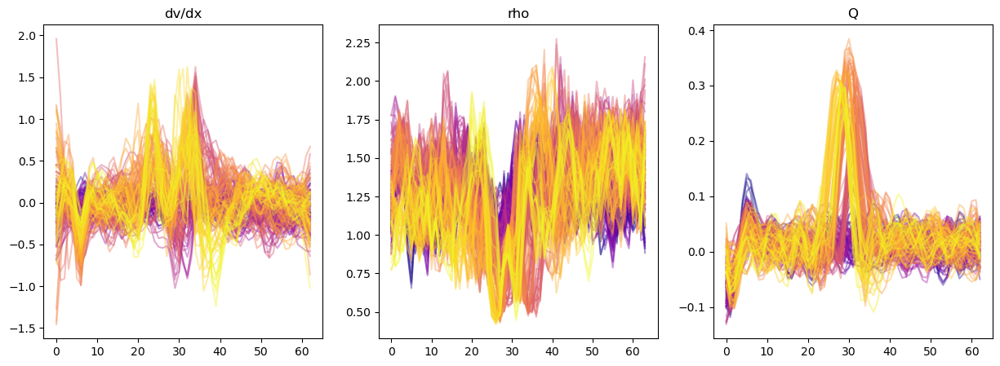

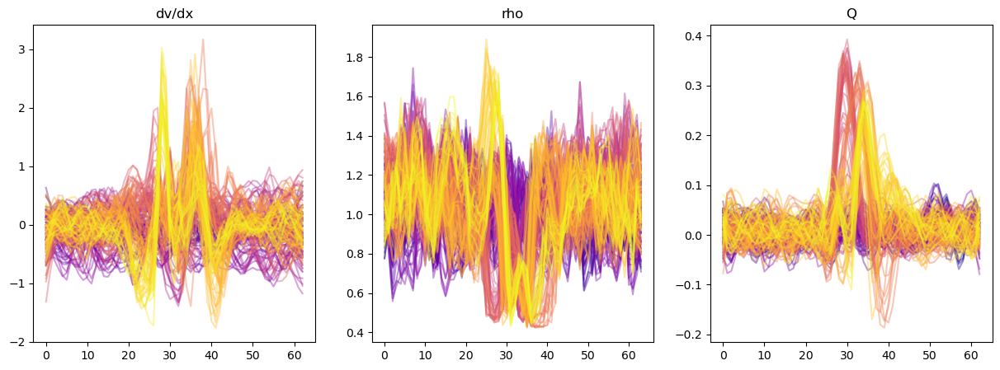

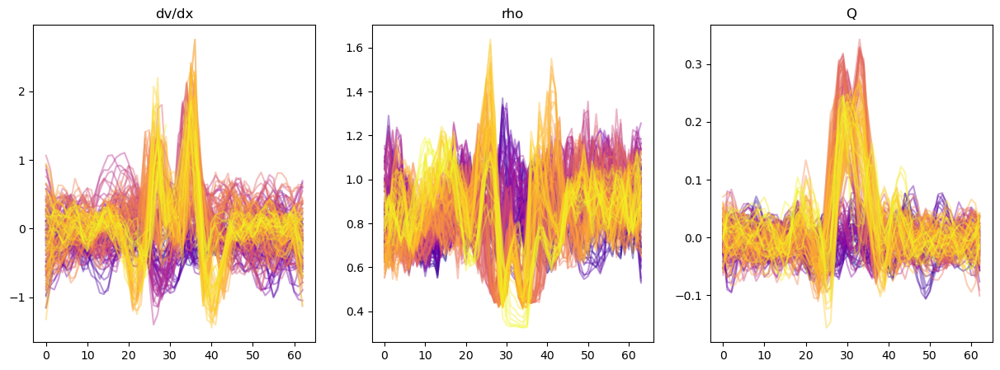

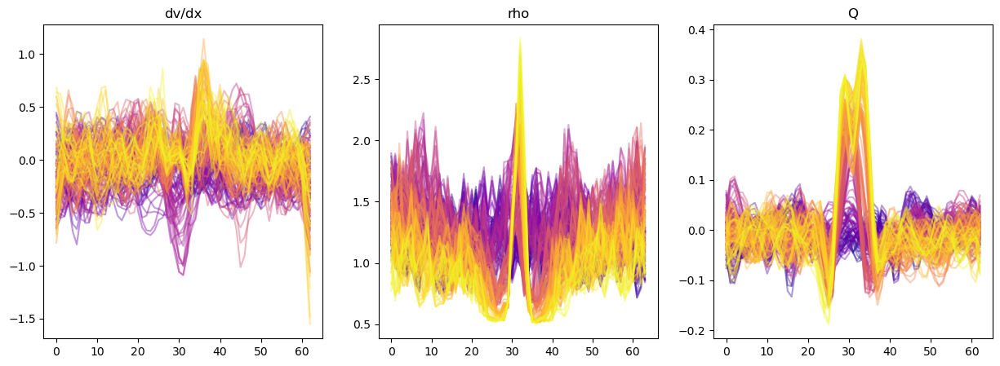

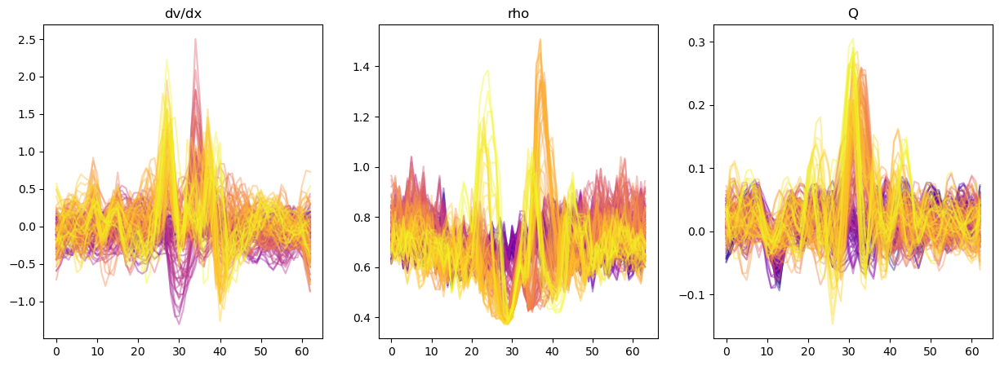

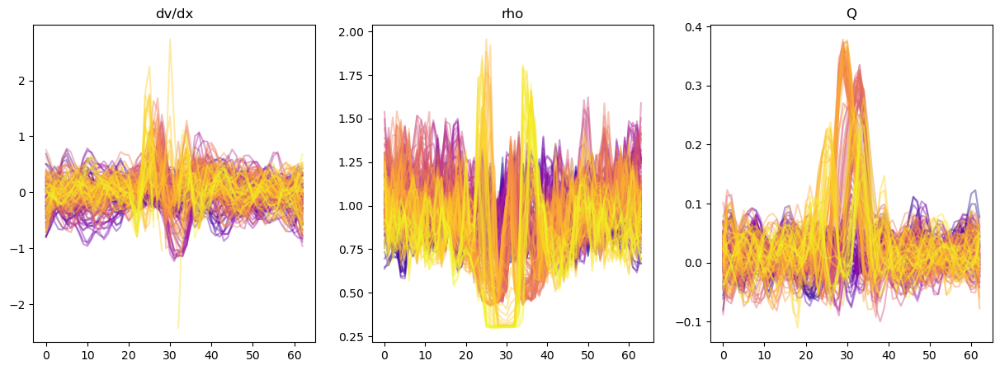

In [7]:
T = len(dxdvs[0])
colors = plt.cm.plasma(np.linspace(0, 1, T))
for n in range(len(rhos)):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    for i in range(T): 
        axes[0].plot(dxdvs[n][i], alpha=0.4, color=colors[i])
        axes[1].plot(m_rhos[n][i], alpha=0.4, color=colors[i])
        axes[2].plot(int_Qs[n][i], alpha=0.4, color=colors[i])
    axes[0].set_title('dv/dx')
    axes[1].set_title('rho')
    axes[2].set_title('Q')
    plt.show() 

In [8]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

times = np.linspace(0, 1, T)
X = np.linspace(-0.5, 0.5, dxdvs[0].shape[-1])

X_grid, T_grid = np.meshgrid(X, times)
X_flatten = X_grid.flatten() 
T_flatten = T_grid.flatten()


chi0s = [] 
chi1s = []

for n in range(len(rhos)):

    rho = m_rhos[n][:, :-1]
    Q = int_Qs[n] 
    dxdv = dxdvs[n] 


    A = (rho - np.mean(rho, axis=-1)[:, np.newaxis]).flatten()
    B = (-Q + np.mean(Q, axis=-1)[:, np.newaxis]).flatten()
    f = dxdv.flatten() 
    m = np.isfinite(A) & np.isfinite(f) & np.isfinite(B)
    f = f[m] 

    model = LinearRegression(fit_intercept=False)  # No intercept as our function doesn't have one

    C = np.column_stack((A[m], B[m]))

    model.fit(C, f)
    a, b = model.coef_
    print(model.coef_) 
    chi0s.append(-a)
    chi1s.append(-b) 


    # Create a figure with 3D axes
    fig = make_subplots(specs=[[{'type': 'scene'}]])

    # Add the scatter trace
    fig.add_trace(
        go.Scatter3d(
            x=A[m],
            y=B[m],
            z=f,
            mode='markers',
            marker=dict(
                # size=df['size'],
                color=(f-a*A[m]-b*B[m])**2,
                colorscale='RdPu_r',
                opacity=0.4
            ),
            name='Scatter Points'
        )
    )

    # Create the surface data (z as a function of x and y)
    # Example function: z = sin(x) * cos(y)
    x_range = np.linspace(np.min(A[m]), np.max(A[m]), 50)
    y_range = np.linspace(np.min(B[m]), np.max(B[m]), 50)
    x_surf, y_surf = np.meshgrid(x_range, y_range)
    z_surf = a*x_surf+b*y_surf

    # Add the surface trace
    fig.add_trace(
        go.Surface(
            x=x_surf,
            y=y_surf,
            z=z_surf,
            colorscale='Blues',
            opacity=0.6,
            showscale=False,
            name='linear fit'
        )
    )

    # Update layout
    fig.update_layout(
        title='3D Scatter Plot with Surface',
        scene=dict(
            xaxis_title='rho',
            yaxis_title='Q',
            zaxis_title='dv/dx'
        ),
        width=800,
        height=800
    )

    # Show the figure
    fig.show()



[-0.03496057 -0.59959169]


[-0.24274159 -0.6449265 ]


[-0.3922892  -0.47568435]


[-0.17664574 -0.23393534]


[-0.42545471 -0.50165302]


[-0.27371257 -1.11860675]


[-0.27763333 -0.23912652]


[-0.55137395 -0.00933233]


[-0.2948085   0.01594331]


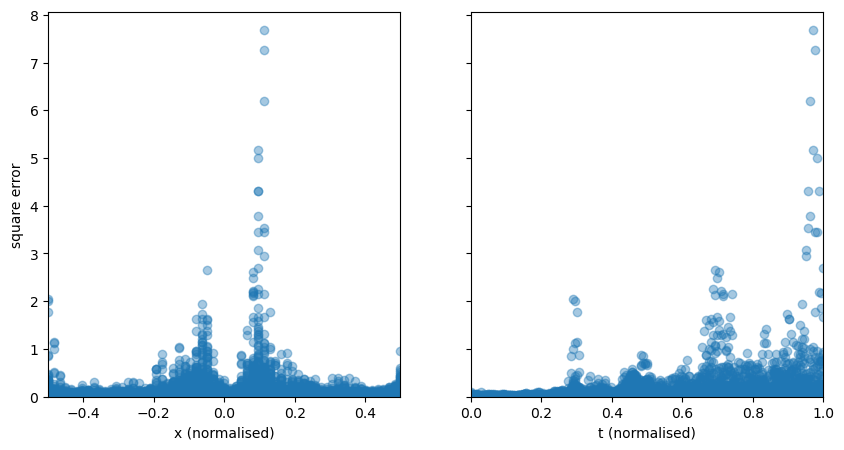

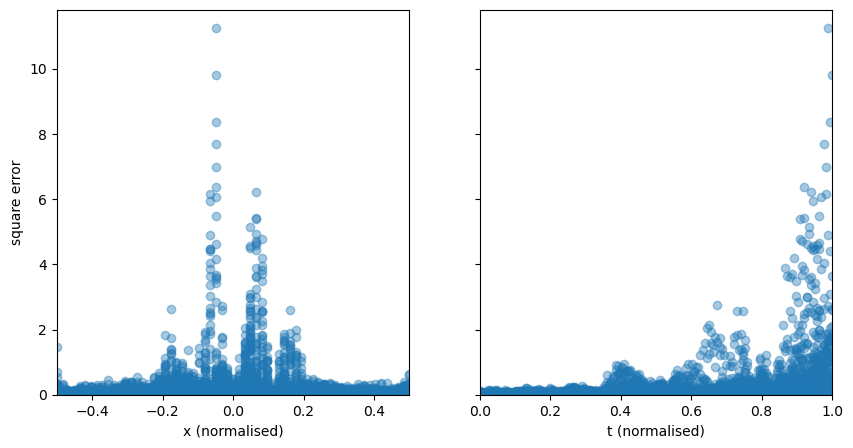

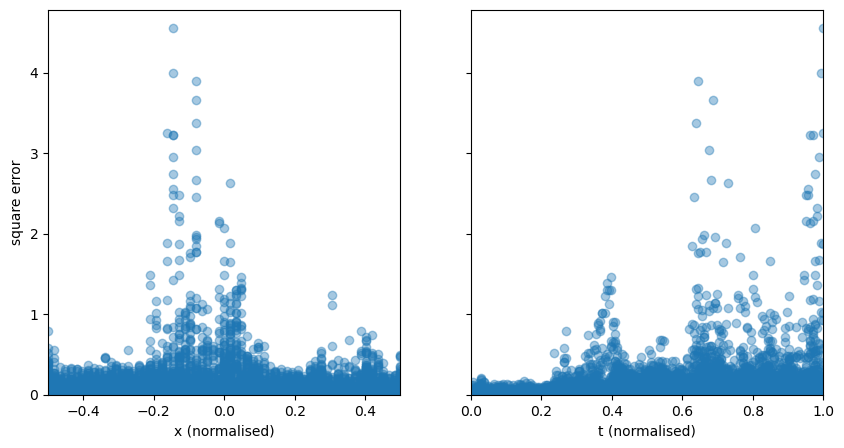

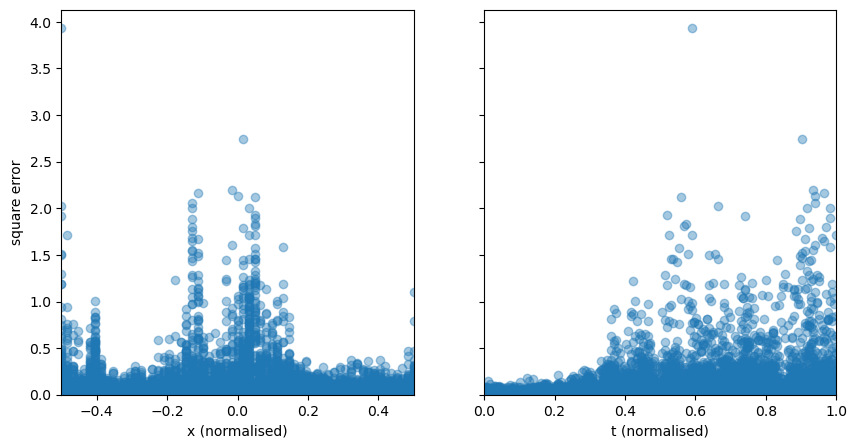

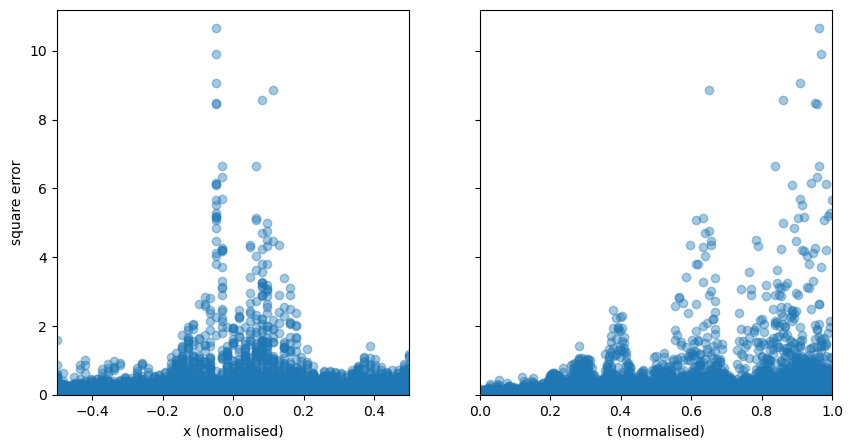

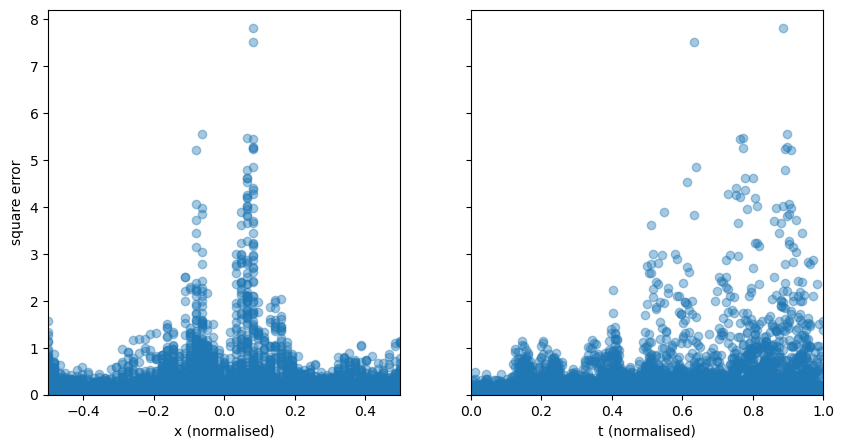

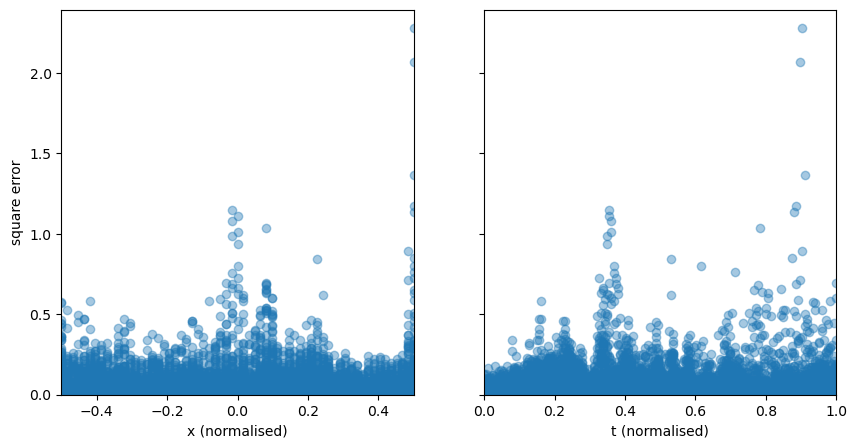

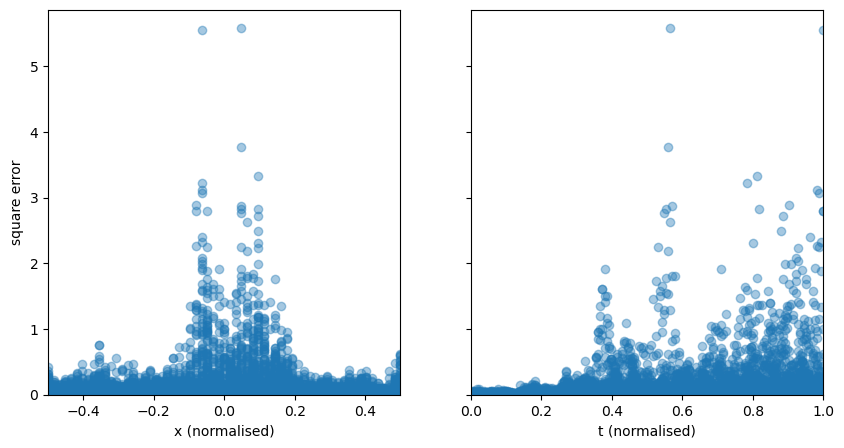

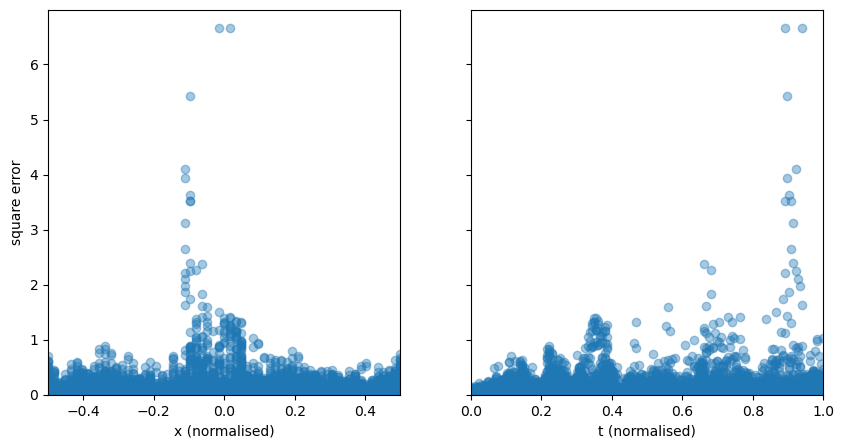

In [193]:
for n in range(len(rhos)):
    a = - chi0s[n]
    b = - chi1s[n] 

    rho = m_rhos[n][:, :-1]
    Q = int_Qs[n] 
    dxdv = dxdvs[n] 


    A = (rho - np.mean(rho, axis=-1)[:, np.newaxis]).flatten()
    B = (-Q + np.mean(Q, axis=-1)[:, np.newaxis]).flatten()
    f = dxdv.flatten() 
    m = np.isfinite(A) & np.isfinite(f) & np.isfinite(B)
    f = f[m] 

    

    fig, axes = plt.subplots(1, 2, figsize=(10, 5), sharey=True)

    axes[0].scatter(X_flatten[m], (a*A[m] + b*B[m] - f)**2, alpha=0.4)
    axes[0].set_ylim([0, None])
    axes[0].set_xlim([-0.5, 0.5])
    axes[0].set_xlabel('x (normalised)')
    axes[0].set_ylabel('square error')

    axes[1].scatter(T_flatten[m], (a*A[m] + b*B[m] - f)**2, alpha=0.4)
    axes[1].set_xlim([0, 1])
    axes[1].set_xlabel('t (normalised)')
    plt.show() 



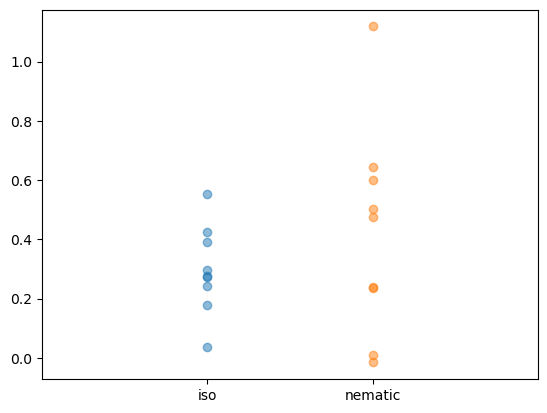

In [194]:
plt.plot(np.ones(len(chi0s)), chi0s, 'o', alpha=0.5)
plt.plot(2*np.ones(len(chi1s)), chi1s, 'o', alpha=0.5)
plt.xlim([0, 3])
plt.xticks([1, 2], ['iso', 'nematic'])
plt.show() 

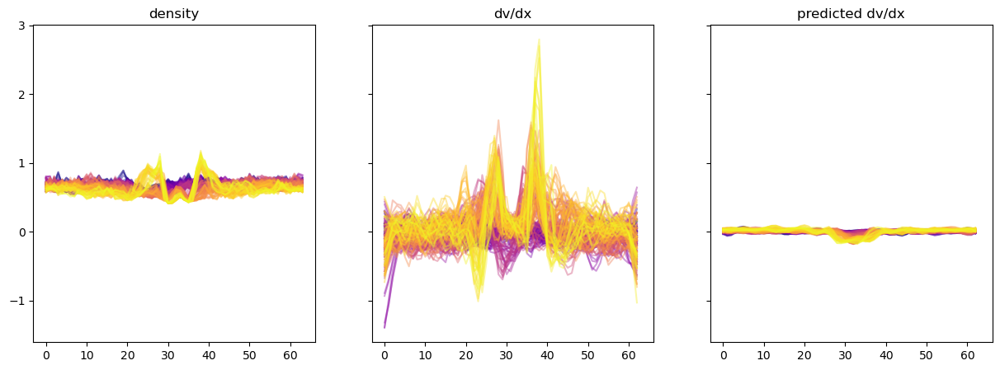

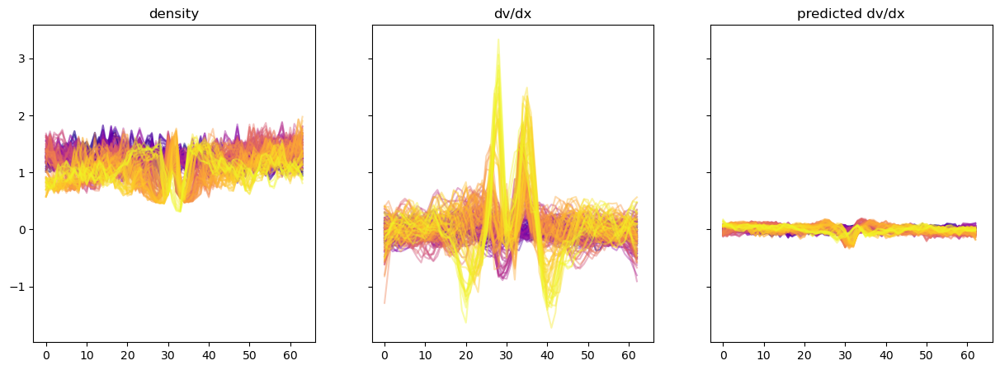

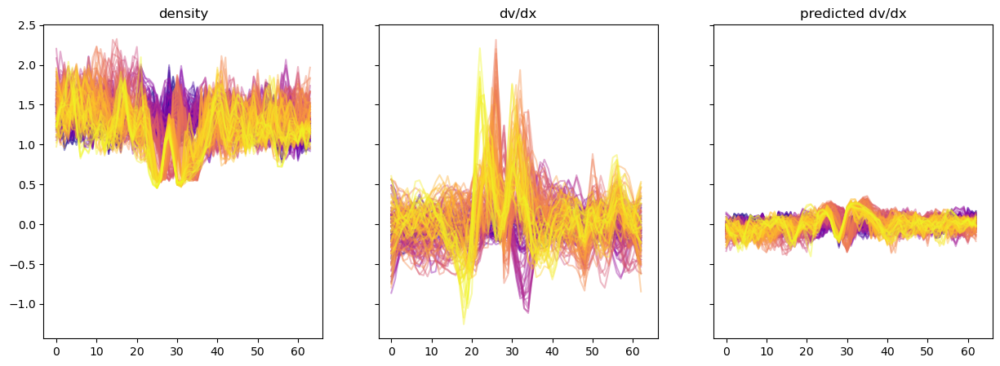

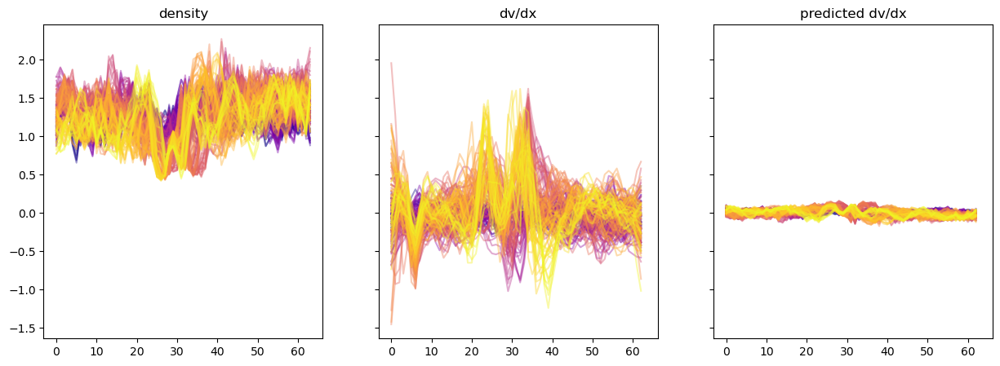

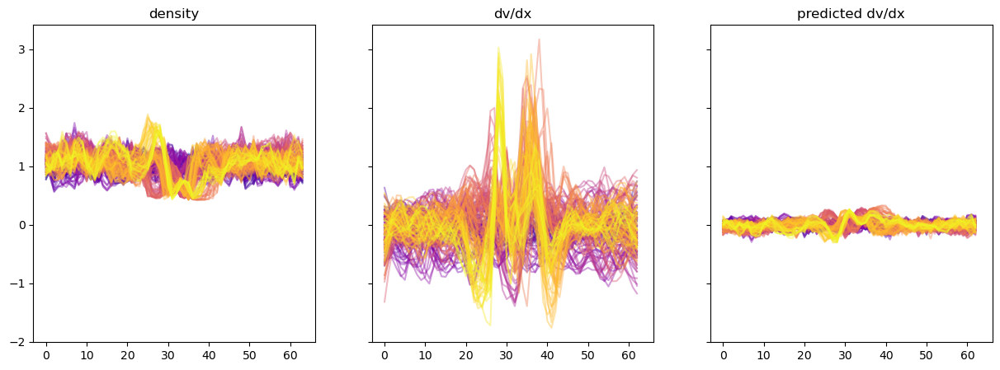

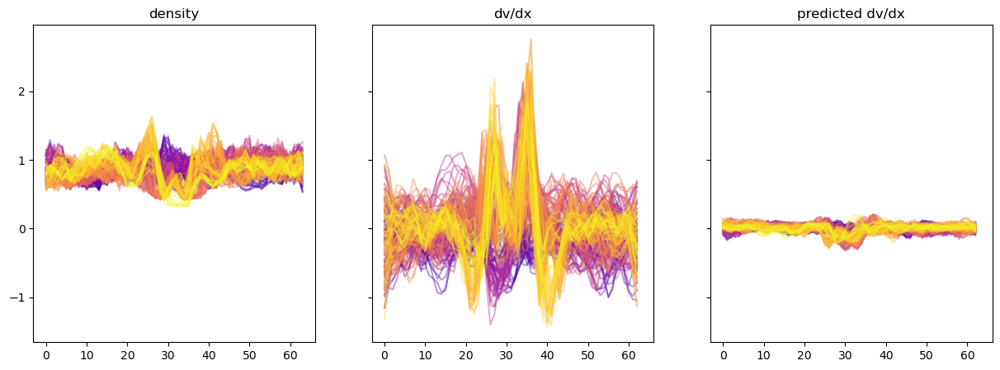

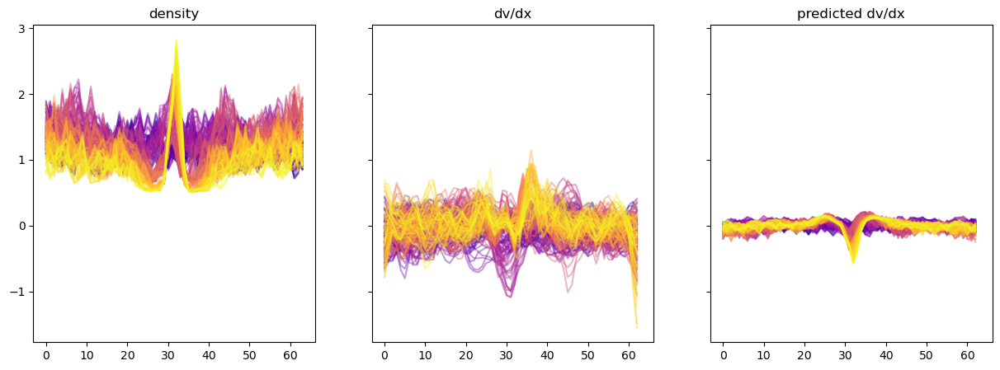

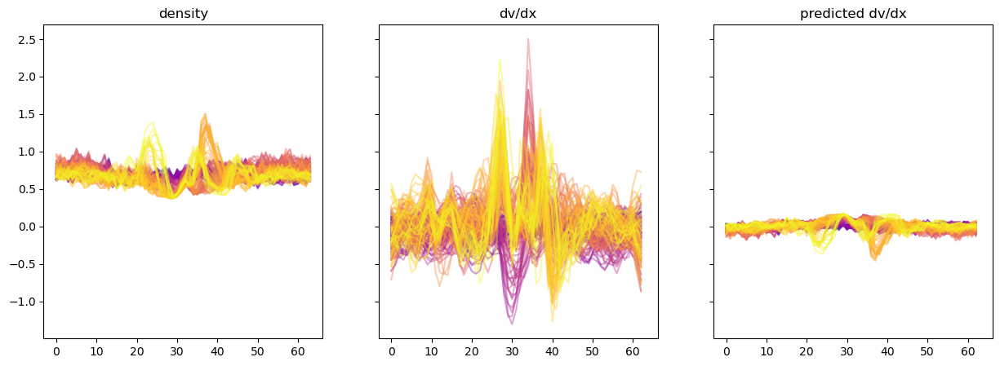

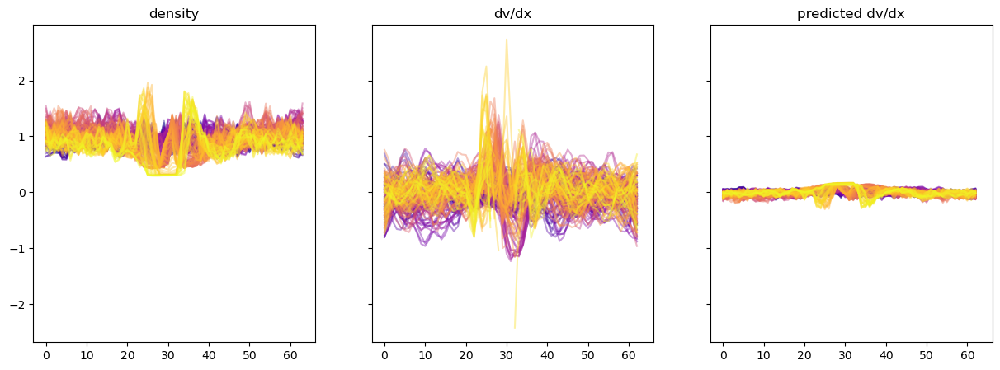

In [202]:



colors = plt.cm.plasma(np.linspace(0, 1, T))
for n in range(len(rhos)):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True, sharey=True)
    rho = m_rhos[n][:, :-1]
    rho = rho - np.mean(rho, axis=-1)[:, np.newaxis]
    Q = int_Qs[n] 
    Q = Q - np.mean(Q, axis=-1)[:, np.newaxis]
    a = chi0s[n]
    b = chi1s[n]
    dxdv_pred = - a*rho - b*Q 
    for i in range(T): 
        axes[0].plot(m_rhos[n][i], alpha=0.4, color=colors[i])
        axes[1].plot(dxdvs[n][i], alpha=0.4, color=colors[i])
        axes[2].plot(dxdv_pred[i], alpha=0.4, color=colors[i])
    axes[0].set_title('density')
    axes[1].set_title('dv/dx')
    axes[2].set_title('predicted dv/dx')
    plt.show() 